Libraries to be used for our image treatement and mesh purposes


In [1]:
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import root
from PIL import Image
import imageio
import trimesh
import os
import scipy.linalg as slin
import pickle
import plotly.express as px
import plotly.graph_objects as go
from skimage.measure import marching_cubes
import nbformat
import plotly.express as px
import pandas as pd
import plotly.subplots as sp
import random


# 2D Wasserstein Barycenter

The idea here is to do a Wasserstein Barycenter using Sinkhorn algorithm that uses entropic regularization. 
Now since the algorithm relies on calculating $\Sigma e^{-  \frac{d(x_i,x_j)^2}{\gamma}} u[i,j] $ for all pairs of points inside our distribution space $[0,1]^n$, this could be very time complex if calculated naively specially when dealing with high dimension spaces.
To put this into prespective, calculating the pairwise distances for an $n^3$ discritization of space $[0,1]^3$ we'd have to calculate $n^6$ pairs of values, which can be extreme.
Instead using convolution we can get to a complexity of $O(n^d)$ where d is the dimension of the space, this means we get to a linear complexity in term of number of elements in our discritization.
To 


In [2]:

def convolution2D(E,u):
    n = len(E)
    u= u.reshape(n,n)
    E2 = np.zeros(2*n-1)
    E2[:n]= np.flip(E) 
    E2[n-1:]=E
    E = E2
    conv_lignes= []
    for j in range(n):
        conv_lignes+=[np.convolve(u[j,:],E).tolist()]
    conv_lignes= np.array(conv_lignes)
    conv_lignes= conv_lignes[:,n-1:2*n-1]
    conv_columns = []
    for j in range(n):
        conv_columns+=[np.convolve(conv_lignes[:,j],E).tolist()]
    return(np.array(conv_columns)[:,n-1:2*n-1].T.flatten())

def classical2D(E,u,gamma):
    n = len(E)
    u= u.reshape(n,n)
    expected_result = np.zeros((n, n))
    for l in range(n):
        for c in range(n):
            expected_result[l, c] = sum(np.exp(-(l-a)**2/(gamma*n**2)) * sum(np.exp(-(c-b)**2/(gamma*n**2)) * u[a, b] for b in range(n)) for a in range(n))
    return expected_result.flatten()


Comparaison of execution times ! 

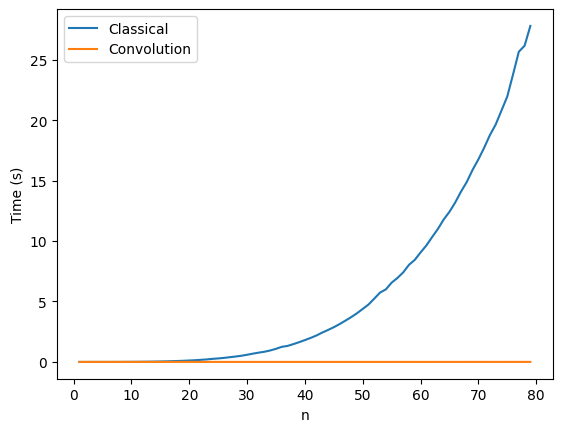

In [3]:
import time 
n_tests =40
classic = []
conv = [] 
for n in range(1, n_tests):
    u = np.zeros((n, n))
    u[:, :n] = np.random.rand(n, n)
    gamma = 0.1

    start_time = time.time()
    E = np.exp([-i*i/gamma/n**2 for i in range(n)])
    convolution2D(E, u)
    dur1 = time.time() - start_time

    start_time = time.time()
    classical2D(E, u, gamma)
    dur2 = time.time() - start_time
    classic.append(dur2)
    conv.append(dur1)

# Plot the results
n_range = range(1, n_tests)
plt.plot(n_range, classic, label='Classical')
plt.plot(n_range, conv, label='Convolution')
plt.legend()
plt.xlabel('n')
plt.ylabel('Time (s)')
plt.show()

### Entropic Sharpening:
It's used to sharpen the results of convolution (that are blurred due to the entropic regularization)

In [40]:
def H(mu,a):
    return(-sum([0 if mu[i] == 0 else a[i]*mu[i]*np.log(mu[i]) for i in range(len(a))]))
def FIND_ROOT(equation, constraints):
    root_result = root(equation, [0])
    if root_result.success:
        root_value = root_result.x[0]
        if constraints(root_value):
            return root_value
        else:
            raise ValueError("Root value does not satisfy constraints.")
    else:
        raise ValueError("Root finding failed.")


def ENTROPIC_SHARPENING(mu, entropy_bound, a):
    beta = 1 
    
    if H(mu,a) + a.T@mu > entropy_bound + 1:
        beta = FIND_ROOT(a.T@(mu**beta) + H(mu**beta,a) - (1 + entropy_bound), beta >= 0)
    return mu**beta

Wasserstein barycenter 2D using Sinkhorn's algorithm

In [41]:


def Wass_Bary2D(mus, coef,a,n,gamma = 0.01, iter = 100,entropic_sharpening=True):

    k = len(mus)

    v = np.ones((k,n**2))
    w = np.ones((k,n**2))
    d = np.zeros((k,n**2))
    eps = 1e-20 
    for i in range(k) : 
        mus[i] +=eps
    E = np.exp([-i*i/(gamma/2)/n**2 for i in range(n)])
    for j in range(iter):
        bary = np.ones(n**2)
        for i in range(k):
            w[i] = mus[i]/convolution2D(E,a*v[i])
            d[i] = v[i]*convolution2D(E,a*w[i])
            bary = bary*(d[i]**coef[i])
        if(entropic_sharpening):
            bary = ENTROPIC_SHARPENING(bary,max(H(u,np.array(a)) for u in mus),np.array(a))
        for i in range(k):
            v[i]=v[i]*bary/(d[i])

    return bary



Let's load some shapes and test our function

In [42]:

def load_image(name):
    # Load the image
    img = Image.open(name)

    # Convert the image to a binary image (black and white)
    img = img.convert("1")

    # Convert the image to a matrix of ones and zeros
    matrix = np.array(img)
    matrix =np.array( [ np.array([0. if matrix[i][j] else 1. for j in range(len(matrix[0]))]) for i in range(len(matrix)) ])

    return(matrix/np.sum(matrix))



In [43]:
path = './2015-SIGGRAPH-convolutional-ot-master (1) - Copy/2015-SIGGRAPH-convolutional-ot-master\data\images\shapes/'
dots = load_image(path+"shape2filled.png")
star = load_image(path+"shape3filled.png")
fivestar = load_image(path+"shape4filled.png")
circle = load_image(path+"shape1filled.png")


n=star.shape[0]



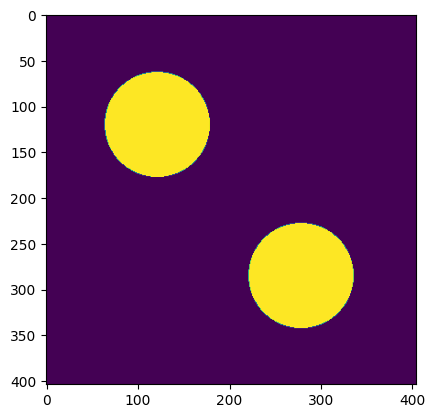

In [44]:
plt.imshow(dots)


In [45]:
dots= dots.reshape(-1)
star = star.reshape(-1)
circle = circle.reshape(-1)
fivestar = fivestar.reshape(-1)

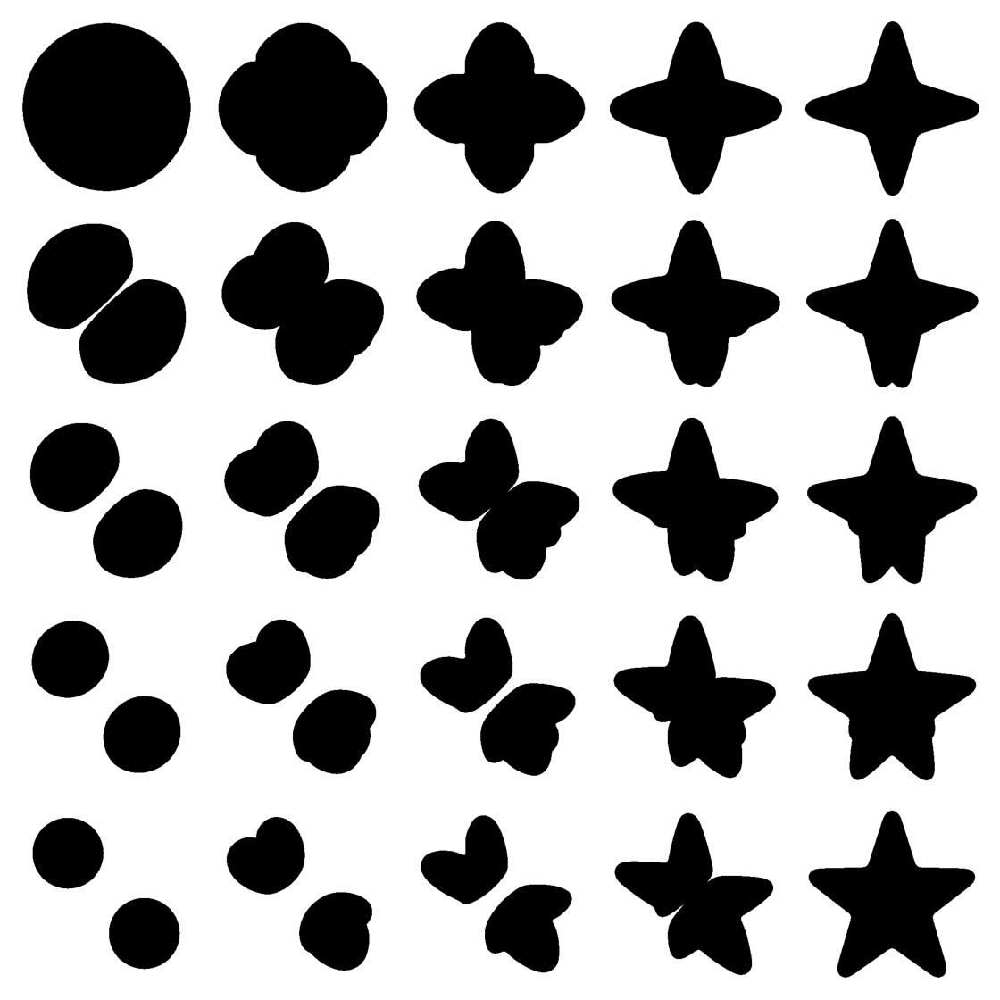

In [46]:
grid_size = 5
fig, axes = plt.subplots(nrows=grid_size, ncols=grid_size, figsize=(11, 11))

for i in range(grid_size):
    for j in range(grid_size):
        coef = 1.0/(grid_size-1)**2*np.array([(grid_size-1-j)*(grid_size-1-i),j*(grid_size-1-i),j*i,(grid_size-1-j)*i])
        bary = Wass_Bary2D([circle,star,fivestar,dots], coef,np.ones((n**2))/(0.+n**2),n,gamma = 0.0015, iter = 3,entropic_sharpening = True)
        bary = bary.reshape(n,n)
        threshold = 1e-6
        bary = np.where(bary > threshold, 1, 0)
        axes[i,j].imshow(bary,cmap='binary')
        axes[i,j].set_axis_off() # turn off axes
        plt.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=0, hspace=0) # adjust spacing


plt.show()

In [47]:

n_images = 20 
images = []

for i in range(n_images):
    bary = Wass_Bary2D([dots,star], [1.0/n_images*i,(1-1.0/n_images*i)],np.ones((n**2))/(0.+n**2),n,gamma = 0.0015, iter = 3,entropic_sharpening= False)
    bary = bary.reshape(n,n)
    threshold = (1e-6)*5
    bary = np.where(bary > threshold, 1, 0)
    # Plot the heatmap using imshow
    plt.imshow(bary, cmap='binary')
    plt.axis('off') # turn off axes to make gif cleaner
    plt.savefig(f"image_{i}.png", bbox_inches='tight') # save figure as png
    plt.close()
    images.append(imageio.imread(f"image_{i}.png")) # add image to list for gif
gif_path = 'dots_to_star.gif'
# create gif from list of images
imageio.mimsave(gif_path, images, duration=0.1)



C:\Users\Alhus\AppData\Local\Temp\ipykernel_13256\2948951329.py:14: DeprecationWarning:

Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.



![Alt text](dots_to_star.gif)

Face interpolation

In [48]:
def load_BW_portrait(name):
    "Load a black and white portrait"
    # Load the image
    img = Image.open(name)

    # Convert the image to a binary image (black and white)
    img = img.convert("L")

    # Convert the image to a matrix of ones and zeros
    matrix = np.array(img)

    return(matrix/np.sum(matrix)) #/np.sum(matrix)

def load_rgb_image(name):
    "Load a color (RGB) image"
    img = Image.open(name)
    matrix = np.array(img, dtype='float')
    A = 255* np.ones((matrix.shape[0],matrix.shape[0]))
    for k in range(matrix.shape[2]):
        matrix[:,:,k] = A-matrix[:,:,k]
        matrix[:,:,k] /= 255
    return(matrix)

In [49]:
import imageio
def interpolate_2D_BW(mus, n_images = 10, coeff = None, gamma = 0.004, threshold = 1e-5, n_iter=100):
    L = []
    n = (int)((mus[0].shape[1])**0.5)

    if n_images == 1:
        bary = Wass_Bary2D(mus, coeff,np.ones((n**2))/(0.+n**2),n,gamma = gamma, iter = n_iter, entropic_sharpening=False)
        bary = bary.reshape(n,n)
        if threshold != None:
            bary = np.where(bary > threshold, 1, 0)
        # Plot the heatmap using imshow
        plt.imshow(bary, cmap='binary')
        plt.colorbar()
        plt.show()
        L = bary
    else:
        for i in range(n_images+1):
            bary = Wass_Bary2D(mus, [i/n_images,(n_images-i)/n_images],np.ones((n**2))/(0.+n**2),n,gamma = gamma, iter = n_iter, entropic_sharpening=False)
            bary = bary.reshape(n,n)
            # Plot the heatmap using imshow
            plt.imshow(bary, cmap='binary')
            #plt.colorbar()
            plt.savefig("monge_kant"+str(i)+".png", bbox_inches = 'tight')
            L.append(imageio.imread("monge_kant"+str(i)+".png"))
            plt.show()
    return L

def interpolate_2D_RGB(mus, n_images = 10, coeff = None, gamma = 0.0003, n_iter=100):
    n = mus[0].shape[0]
    A = np.ones((n,n))
    d1 = mus[0]
    d2 = mus[1]
    f_bary = []
    if n_images == 1:
        for i in range(d1.shape[2]):
            d1_bis = d1[:,:,i].reshape(1,-1)
            d2_bis = d2[:,:,i].reshape(1,-1)
            bary = Wass_Bary2D([d1_bis, d2_bis], coeff,np.ones((n**2))/(0.+n**2),n,gamma = gamma, iter = n_iter, entropic_sharpening=False)
            bary = bary.reshape(n,n)
            f_bary.append(A-bary)

        f_image = np.dstack(f_bary)
        plt.imshow(f_image)
        plt.show()
    else:
        for i in range(n_images+1):
            f_bary = []
            for j in range(d1.shape[2]):
                d1_bis = d1[:,:,j].reshape(1,-1)
                d2_bis = d2[:,:,j].reshape(1,-1)
                bary = Wass_Bary2D([d1_bis, d2_bis], [i/n_iter,(n_iter-i)/n_iter],np.ones((n**2))/(0.+n**2),n,gamma = gamma, iter = n_iter, entropic_sharpening=False)
                bary = bary.reshape(n,n)
                f_bary.append(A-bary)

            f_image = np.dstack(f_bary)
            plt.imshow(f_image)
            plt.show()
    return

In [50]:
epsilon = 0
monge = load_BW_portrait("Jamil_0.jpg").reshape((1,-1))+epsilon*np.ones((1,282**2))
m = np.max(monge) #np.ones((1,163**2))-
monge = m*np.ones((1,282**2))-monge
kant = load_BW_portrait("jean-baptiste_0.jpg").reshape((1,-1))+epsilon*np.ones((1,282**2))
m = np.max(kant)
kant = m*np.ones((1,282**2))-kant
L = interpolate_2D_BW([monge, kant], n_images = 1, coeff=[0.5,0.5], gamma = 0.0002, n_iter=100, threshold=None)

FileNotFoundError: [Errno 2] No such file or directory: 'Jamil_0.jpg'

In [ ]:
L = interpolate_2D_BW([monge, kant], n_images = 20, gamma = 0.0002, n_iter=100, threshold=None)
imageio.mimsave("test_jb-jamil-sharpening-4.gif", L, duration = 0.1)

![Alt text](test_jb-jamil-sharpening-4.gif)

# 3D Wasserstein Barycenter


As for the 2D case we are going to start by defining the convolution as well as the Sinkhorn's algorithm for 3d distributions. 

In [51]:
def convolution3D(E,u):
    n = len(E)
    u= u.reshape(n,n,n)
    E2 = np.zeros(2*n-1)
    E2[:n]= np.flip(E) 
    E2[n-1:]=E
    E = E2

    conv_lignes= []
    for depth in range(n):
        temp =[]
        for line in range(n):
            temp+=[np.convolve(u[depth,line,:],E).tolist()]
        conv_lignes+=[temp]
    conv_lignes= np.array(conv_lignes)[:,:,n-1:2*n-1]
    conv_columns = []
    for depth in range(n):
        temp =[]
        for column in range(n):
            temp+=[np.convolve(conv_lignes[depth,:,column],E).tolist()]
        conv_columns+=[temp]
    conv_columns= np.array(conv_columns)[:,:,n-1:2*n-1]
    for depth in range(n):
        conv_columns[depth,:,:] = conv_columns[depth,:,:].T

    conv_depth = []
    for line in range(n):
        temp =[]
        for column in range(n):
            temp+=[np.convolve(conv_columns[:,line,column],E).tolist()]
        conv_depth+=[temp]
    conv_depth=np.transpose(np.array(conv_depth)[:,:,n-1:2*n-1],(2,0,1))

    return(conv_depth.flatten())


def classical3D(E,u,gamma):
    n = len(E)
    v= u.reshape(n,n,n)

    expected_result = np.zeros((n, n,n))
    for d in range(n):
        for l in range(n):
            for c in range(n):
                expected_result[d,l, c] =sum(np.exp(-((d-r)/n)**2/(gamma/2)) *sum(np.exp(-((l-a)/n)**2/(gamma/2)) * sum(np.exp(-((c-b)/n)**2/(gamma/2)) * v[r,a, b] for b in range(n)) for a in range(n)) for r in range(n))
    
  
    return expected_result

In [52]:
def Wass_Bary3D(mus, coef,a,n, L=None,prefactorized = True ,conv  = False,iter = 100,gamma = 0.01,entropic_sharpening = True):
    k = len(mus)
    
    v = np.ones((k,n**3))
    w = np.ones((k,n**3))
    d = np.zeros((k,n**3))
    eps = 1e-20
    E = np.exp([-i*i/(gamma/2)/n**2 for i in range(n)])
    
    #add small epsilon to the distributions 
    for i in range(k):
        mus[i]+=eps
    if(not prefactorized and not conv):
        L_inv = np.linalg.inv(L)
    for j in range(iter):
        bary = np.ones(n**3)
        for i in range(k):
            if(not conv):
                if(prefactorized):
                    w[i] = mus[i]/slin.solve_triangular(L.T,slin.solve_triangular(L,a*v[i],lower=True))
                    d[i] = v[i]*slin.solve_triangular(L.T,slin.solve_triangular(L,a*w[i],lower=True))

                else:
                    w[i] = mus[i]/(L_inv@(a*v[i]))
                    d[i] = v[i]*(L_inv@(a*w[i]))
            else:
                w[i] = mus[i]/convolution3D(E,a*v[i])
                d[i] = v[i]*convolution3D(E,a*w[i])
            bary = bary*(d[i]**coef[i])
        if(entropic_sharpening):
            bary = ENTROPIC_SHARPENING(bary,max(H(u,np.array(a)) for u in mus),np.array(a))
        for i in range(k):

            v[i]=v[i]*(bary/(d[i]))
    return bary

We'll be working with triangular meshes for this part, we'll show how to properly process them before applying the algorithms.
Let's define a class to make it easier to treat our imported meshes.

In [53]:
#unflattens a 1d array
def i_to_xyz(i,n):
    z = i // (n*n)
    i = i % (n*n)
    y = i // n
    x = i % n
    return (x, y, z)
#flattens a 3d array
def xyz_to_i(x,y,z,n):
    return(n*n*x+n*y+z)


#writes mesh to an .off file
def write_off(filename, verts, faces):
    with open(filename, 'w') as f:
        f.write("OFF\n")
        f.write("%d %d 0\n" % (len(verts), len(faces)))
        for vert in verts:
            f.write("%f %f %f\n" % tuple(vert))
        for face in faces:
            f.write("3 %d %d %d\n" % tuple(face))
class Mesh: 
    def __init__(self):
        self.distribution = None
        self.binary_distribution = None 
        self.binary = None 
        self.count = None 
        self.mesh = None 
        self.points = None
        self.n = 0 
        self.cot_laplacian = None

    #adds more points to the monte_carlo method
    def update_distribution(self, num_points):
        points=np.random.rand(num_points,3)
        mask = self.mesh.contains(points)
        for p,m in zip(points,mask):
            if(m):
                x = int(p[0]*self.n)
                y = int(p[1]*self.n)
                z = int(p[2]*self.n)
                self.points.append(p)
                self.count[xyz_to_i(x,y,z,self.n)] +=1
        self.distribution= self.count/sum(self.count)
        for i in range(self.n**3):
            if(self.count[i]>0):
                self.binary[i]=1
        self.binary_distribution= self.binary/self.binary.sum()

    #creates a distribution on [0,1]^3 after being cut into n_cuts^3 elements
    def find_distribution(self,n_cuts=20,num_points = 10000):    
        self.n = n_cuts
        points = np.random.rand(num_points, 3)
        self.binary_distribution = np.zeros(n_cuts**3)
        self.binary = np.zeros(n_cuts**3)
        #apply monte carlo method to estimate distribution 
        # Check which points are inside the mesh
        mask = self.mesh.contains(points)
        print("Done masking")
        self.distribution = np.zeros(n_cuts**3)
        inside = []
        for p,m in zip(points,mask):
            if(m):
                x = int(p[0]*n_cuts)
                y = int(p[1]*n_cuts)
                z = int(p[2]*n_cuts)
                inside.append(p)
                self.distribution[xyz_to_i(x,y,z,n_cuts)] +=1
        self.count = self.distribution.copy()
        self.distribution/=sum(self.distribution)
        print("Done Calculating Distribution")
        threshold = max(self.distribution)/2
        for i in range(n_cuts**3):
            if(self.count[i]>0):
                self.binary[i]=1
        self.binary_distribution= self.binary/self.binary.sum()
        self.points = inside 
    #fills empty spaces in our 0-1 cubical mesh
    def fillBin(self):
        binary = self.binary.copy().reshape((n,n,n))
        for i in range(1,n-1):
            for j in range(1,n-1):
                for k in range(1,n-1):
                    if(binary[i,j,k] ==0):
                        if((binary[i,j,k+1]==1 and binary[i,j,k-1]==1) or (binary[i,j+1,k]==1 and binary[i,j-1,k]==1) or (binary[i+1,j,k]==1 and binary[i-1,j,k]==1)  or (binary[i+1,j+1,k+1]==1 and binary[i-1,j-1,k-1]==1)  or (binary[i+1,j+1,k-1]==1 and binary[i-1,j-1,k+1]==1)  or (binary[i+1,j-1,k+1]==1 and binary[i-1,j+1,k-1]==1)  or (binary[i+1,j-1,k-1]==1 and binary[i-1,j+1,k+1]==1)):
                            binary[i,j,k] =1
        self.binary= binary.flatten()
        self.binary_distribution= self.binary/self.binary.sum()

    def normalize_mesh(self):
        # Find the scale factor to fit the bounding box in [0,1]^3
        scale_factor = min(0.90 / (self.mesh.bounds.max(axis=0)-self.mesh.vertices.min(axis=0)))

        # Apply the scale factor to the mesh
        self.mesh.apply_scale(scale_factor)

        # Translate the mesh so that its minimum vertex is at the origin
        self.mesh.apply_translation(-self.mesh.vertices.min(axis=0))
        min_x = self.mesh.vertices[:,0].min()
        min_y = self.mesh.vertices[:,1].min()
        min_z = self.mesh.vertices[:,2].min()
        max_x = self.mesh.vertices[:,0].max()
        max_y = self.mesh.vertices[:,1].max()
        max_z = self.mesh.vertices[:,2].max()
        self.mesh.apply_translation([0.5-(min_x+max_x)/2,0.5-(min_y+max_y)/2,0.5-(min_z+max_z)/2])


    def cotangent_laplacian_with_area(self):
        cot_weights = {}
        for face in self.mesh.faces:
            i, j, k = face
            v1 = self.mesh.vertices[i]
            v2 = self.mesh.vertices[j]
            v3 = self.mesh.vertices[k]
            a = np.linalg.norm(v2 - v3)
            b = np.linalg.norm(v1 - v3)
            c = np.linalg.norm(v1 - v2)
            s = (a+b+c)/2
            #area weight 
            A = np.sqrt(s*(s-a)*(s-b)*(s-c))

            #angles of a triangle
            alpha = np.arccos((b ** 2 + c ** 2 - a ** 2) / (2 * b * c))
            beta = np.arccos((a ** 2 + c ** 2 - b ** 2) / (2 * a * c))
            gamma = np.arccos((a ** 2 + b ** 2 - c ** 2) / (2 * a * b))

            #their cot
            cot_alpha = A/np.sin(alpha)
            cot_beta = A/np.sin(beta)
            cot_gamma = A/np.sin(gamma)

            
            cot_weights[(i, j)] = cot_alpha
            cot_weights[(j, k)] = cot_beta
            cot_weights[(k, i)] = cot_gamma
        n = len(self.mesh.vertices)
        laplacian = np.zeros((n, n))
        for (i, j), w in cot_weights.items():
            laplacian[i, i] += w
            laplacian[j, j] += w
            laplacian[i, j] -= w
        self.laplacian = laplacian



Import some meshes

In [54]:
#using trimesh to import and normalize
import trimesh


meshes = []
meshes_names =[]
path = "2015-SIGGRAPH-convolutional-ot-master (1) - Copy/2015-SIGGRAPH-convolutional-ot-master/data/meshes"
for file in os.listdir(path):
    name = file[:-4].replace('-','')
    meshes_names+=[name]
    exec(name+" = "+"Mesh()")
    meshes+=[eval(name)]
    exec(name+".mesh = trimesh.load(path+\"/\"+file)")


In [55]:
scene = trimesh.Scene([meshes[meshes_names.index("duck")].mesh])
scene.show()


Start by importing those meshes as distribution or creating those distributions using a monte-carlo method.

In [56]:
n_points_thousand = 6
#number of cuts in each axe
n = 40
#initial number of points for monte-carlo
n_pts = 1000

for m in meshes:
    m.normalize_mesh()
    m.find_distribution(n,n_pts)

    
for i,m in enumerate(meshes):
    print(meshes_names[i])
    if(os.path.isfile((meshes_names[i]+str(n_points_thousand)+'.pkl'))):
        print("already exists")
        with open(meshes_names[i]+str(n_points_thousand)+'.pkl', 'rb') as f:
            meshes[i]=pickle.load(f)
    else:
        for j in range(n_points_thousand):
            m.update_distribution(10000)
        for j in range(3):
            m.fillBin()
        with open(meshes_names[i]+str(n_points_thousand)+'.pkl', 'wb') as f:
            pickle.dump(meshes[i], f)

Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done masking
Done Calculating Distribution
Done maskin

Some ususeful functions for plotting 

In [57]:
x_range = y_range = z_range = [-0.2, 1.2]
def normalize(m):
    # Find the scale factor to fit the bounding box in [0,1]^3
    scale_factor = min(0.9 / (m.bounds.max(axis=0)-m.vertices.min(axis=0)))

    # Apply the scale factor to the mesh
    m.apply_scale(scale_factor)

    # Translate the mesh so that its minimum vertex is at the origin
    m.apply_translation(-m.vertices.min(axis=0))
    min_x = m.vertices[:,0].min()
    min_y = m.vertices[:,1].min()
    min_z = m.vertices[:,2].min()
    max_x = m.vertices[:,0].max()
    max_y = m.vertices[:,1].max()
    max_z = m.vertices[:,2].max()
    m.apply_translation([0.5-(min_x+max_x)/2,0.5-(min_y+max_y)/2,0.5-(min_z+max_z)/2])
def distribution_to_bin(dis):
    binary = np.where(dis>dis.max()/8,1,0)
    return binary   

def smoothed_fig_sub(bin, plot_id):
    # Load binary 3D mesh data
    binary_mesh = bin.reshape((n,n,n))

    # Define the marching cubes parameters
    level = 0.5
    spacing = (1.0, 1.0, 1.0)
    gradient_direction = 'descent'

    binary_mesh_extended = np.zeros((n+2,n+2,n+2))
    binary_mesh_extended[1:n+1,1:n+1,1:n+1] = binary_mesh
    # Create the mesh
    verts, faces, normals, values = marching_cubes(binary_mesh_extended, level, spacing=spacing, gradient_direction=gradient_direction)

    # Create a trimesh object
    mesh = trimesh.Trimesh(vertices=verts, faces=faces)
    normalize(mesh)

    # Smooth the mesh using the Laplacian smoothing algorithm
    mesh = trimesh.smoothing.filter_laplacian(mesh,iterations = 20 )

    # Get the new vertices and faces
    new_verts = mesh.vertices
    new_faces = mesh.faces
    
    # Set the axis range to [0.5, 1]
    x_range = y_range = z_range = [-0.5, 1.5]

    # Create a new subplot with the given ID
    subplot = go.Figure(go.Mesh3d(x=new_verts[:,0], y=new_verts[:,1], z=new_verts[:,2], i=new_faces[:,0], j=new_faces[:,1], k=new_faces[:,2]))
    
    # Update the layout of the subplot
    subplot.update_layout(scene=dict(xaxis=dict(range=x_range), yaxis=dict(range=y_range), zaxis=dict(range=z_range)), scene_aspectratio=dict(x=1, y=1, z=1))

    # Return the subplot
    return subplot,mesh

def point_cloud_plot(points):
    if(len(points)>0):
        points = np.array(points)
        points = pd.DataFrame({"x": points[:,0], "y": points[:,1], "z": points[:,2]})
 
        # Plot the points in 3D
        fig = px.scatter_3d(points, x="x", y="y", z="z" ,width=800, height=600)
        fig.show()


def distribution_to_cloud(dis,scale = 1):
    n = dis.shape[0]
    points = [] 
    n_pts= scale * int(1.0/np.max(dis)*(1.28747 + 468.153 /n**3))
    print(n_pts)
    for i in range(n):
        for j in range(n):
            for k in range(n):
                n_pts_in_cell =min(1, int(dis[i,j,k]*n_pts))
                for p in range(n_pts_in_cell):
                    x = (np.random.rand()+i)
                    y = (np.random.rand()+j)
                    z = (np.random.rand()+k)
                    points.append([x,y,z])
    return(np.array(points))


def plot_3d_binary(binary_distribution ):
    binary_distribution = binary_distribution.reshape((n,n,n))

    print(binary_distribution.sum())
    # extract the coordinates where the matrix is 1

    # create an isosurface with marching cubes algorithm
    vertices, triangles, _, _ = marching_cubes(binary_distribution, level=0)
    vertices = vertices/n
    # create a 3D scatter plot of the vertices with the triangles
    fig = go.Figure(data=[go.Mesh3d(x=vertices[:,0], y=vertices[:,1], z=vertices[:,2], i=triangles[:,0], j=triangles[:,1], k=triangles[:,2], color='lightpink', opacity=1)])

    # set the axis range to [0, 1]
    fig.update_layout(scene=dict(xaxis=dict(range=[0, 1]), yaxis=dict(range=[0, 1]), zaxis=dict(range=[0, 1])))

    # show the plot
    fig.show()


def smoothed_fig(bin):
    # Load binary 3D mesh data
    binary_mesh = bin.reshape((n,n,n))

    # Define the marching cubes parameters
    level = 0.5
    spacing = (1.0, 1.0, 1.0)
    gradient_direction = 'descent'

    # Create the mesh
    verts, faces, normals, values = marching_cubes(binary_mesh, level, spacing=spacing, gradient_direction=gradient_direction)


    # Create a trimesh object
    mesh = trimesh.Trimesh(vertices=verts, faces=faces)
    normalize(mesh)
    # Smooth the mesh using the Laplacian smoothing algorithm
    mesh = trimesh.smoothing.filter_laplacian(mesh,iterations = 20 )

    # Get the new vertices and faces
    new_verts = mesh.vertices
    new_faces = mesh.faces
    # set the axis range to [0, 1]
    fig = go.Figure(data=[go.Mesh3d(x=new_verts[:,0],
                                    y=new_verts[:,1],
                                    z=new_verts[:,2],
                                    i=new_faces[:,0],
                                    j=new_faces[:,1],
                                    k=new_faces[:,2])])
        # Set the axis range to [0, 1]

                                    
    fig.update_layout(scene=dict(xaxis=dict(range=x_range), yaxis=dict(range=y_range), zaxis=dict(range=z_range)), scene_aspectratio=dict(x=1, y=1, z=1))
    fig.show()

def plot_cubic_mesh(binary_distribution):
    X = np.array([])
    Y = np.array([])
    Z = np.array([])
    I,J,K = np.array([]),np.array([]),np.array([])
    cnt = 0
    
    for i, v in enumerate(binary_distribution):

        if v==1:
            
            x, y, z = i_to_xyz(i, n)
            X = np.concatenate((X,np.array([x, x, x+1., x+1., x+0., x, x+1., x+1.])))
            Y = np.concatenate((Y,np.array([y, y+1., y+1., y, y, y+1., y+1., y])))
            Z= np.concatenate((Z, np.array([z, z, z, z, z+1., z+1., z+1., z+1.])))
            #print(X)

            I = np.concatenate((I,8*cnt+np.array([7, 0, 0, 0, 4, 4, 6, 6, 4, 0, 3, 2])))
            J=np.concatenate((J, 8*cnt+np.array([3, 4, 1, 2, 5, 6, 5, 2, 0, 1, 6, 3])))
            K = np.concatenate((K,8*cnt+np.array([0, 7, 2, 3, 6, 7, 1, 1, 5, 5, 7, 6])))
            #print(I)
            cnt +=1
            
    fig = go.Figure(data=[
                go.Mesh3d(
                # 8 vertices of a cube
                x=X/n,
                y=Y/n,
                z=Z/n,
                # i, j and k give the vertices of triangles
                i = I,
                j = J,
                k = K,
                name='y',
                showscale=True
            )
            ])
    fig.update_layout(scene=dict(xaxis=dict(range=x_range), yaxis=dict(range=y_range), zaxis=dict(range=z_range)), scene_aspectratio=dict(x=1, y=1, z=1))
    fig.show()



example of transforming a distribution to a point cloud and to cubes 

In [58]:
point_cloud_plot(distribution_to_cloud(meshes[meshes_names.index('duck')].distribution.reshape(n,n,n),scale = 3))

7233


In [59]:
plot_3d_binary(meshes[meshes_names.index('duck')].binary_distribution)

1.0


MINECRAFT

In [60]:

plot_cubic_mesh(meshes[meshes_names.index('duck')].binary)

Example of interpolation

In [61]:

a = [1.0/(n*n*n)]*(n*n*n)
gamma=0.0015
bin = []

# Define the number of subplots
grid_size =4
num_plots= grid_size**2

choosen_meshes = [np.random.randint(len(meshes)) for _ in range(4)]
choosen_meshes_names = ["duck","torus","mushroom","sphere_102"]
#choosen_meshes_names = random.sample(meshes_names,4)
foldername = ''.join(choosen_meshes_names)+str(grid_size)
os.makedirs("./generated/"+foldername, exist_ok=True)

choosen_meshes = [meshes_names.index(name) for name in choosen_meshes_names]

coefs = []
for i in range(grid_size):
    for j in range(grid_size):
        coef = 1.0/(grid_size-1)**2*np.array([(grid_size-1-j)*(grid_size-1-i),j*(grid_size-1-i),j*i,(grid_size-1-j)*i])
        coefs+=[coef]
        bin+= [Wass_Bary3D(np.array([meshes[k].binary_distribution for k in choosen_meshes]), coef=coef, n=n, a=a ,iter = 3,prefactorized=False,conv=True,gamma=gamma)]
coefs = np.array(coefs).round(1)
    #plot_cubic_mesh(fillBin(distribution_to_bin(x)))
    #smoothed_fig(fillBin(distribution_to_bin(x)))
# Create a new figure with subplots
fig = sp.make_subplots(rows=grid_size, cols=grid_size, specs=[[{'type': 'scene'}]*grid_size]*grid_size)

# Loop over the subplots
for i in range(num_plots):
    # Get the subplot ID
    plot_id = (i // grid_size + 1, i % grid_size + 1)
    # Create the smoothed figure subplot
    subplot,mesh = smoothed_fig_sub(distribution_to_bin(bin[i]), plot_id)
    filename= str(coefs[i][0])+choosen_meshes_names[0]+ "_"+str(coefs[i][1])+choosen_meshes_names[1]+ "_"+str(coefs[i][2])+choosen_meshes_names[2]+ "_"+str(coefs[i][3])+choosen_meshes_names[3]
    trimesh.exchange.export.export_mesh(mesh, "./generated/"+foldername+"/"+filename+".off", file_type="off")
    # Add the subplot to the figure
    fig.add_trace(subplot.data[0], row=plot_id[0], col=plot_id[1])

# Update the layout of the subplots
fig.update_layout(height=800, width=800, title_text=foldername)
fig.show()


Now we explain more usage of the paper, mainly when the distribution is located over a mesh, we can't use convolution here anymore since the distance isn't the Euclidian distance anymore but rather, a geodesic one. 
We are going to need help from the heat kernel, mainly the fact that the geodesic distance could be easily extracted from the kernel. What's so special about the heat kernel is that differential equation that it follows. 
In fact, applying the heat kernel to a discritized mesh represented as n elements (ie in $R^n$) is equivalent to solving the following equation : 
\begin{equation}
w = H_t(v) \Leftrightarrow (D_a + \frac{\gamma}{2}L) w = v
\end{equation}

the latter equivalence can be easily solved using forward and backward subsitution if the matrix $(D_a + \frac{\gamma}{2}L)$ was prefactorized ( we only need to do this once for the space mesh. ) we could use the Cholesky's factorization for that $A = L.L^T$

We have already added a method to the mesh class the generates the cotangent laplacien on that mesh. let's create forward and backward subsitution methods as well as the Cholesky's factorization

In [62]:
def forSub(L, U):
    n = len(U)
    X = [0 for i in range(n)]
    for i in range(n):
        X[i] = U[i]
        for j in range(i):
            X[i] -= L[i][j]*X[j]
        X[i] /= L[i][i]
    return np.array(X)

def backSub(L,U):
    n = len(U)
    X = [0 for i in range(n)]
    for i in range(n-1,-1,-1):
        X[i] = U[i]
        for j in range(i+1,n):
            X[i] -= L[i][j]*X[j]
        X[i] /= L[i][i]
    return np.array(X)

def cholesky(A):
    n = len(A)
    L = np.zeros((n,n))
    for i in range(n):
        print("i = ",i, " / ", n)
        for j in range(i+1):
            s = sum(L[i][k] * L[j][k] for k in range(j))
            if (i == j):
                L[i][j] = np.sqrt(A[i][i] - s)
            else:
                L[i][j] = (1.0 / L[j][j] * (A[i][j] - s))
    return L

Let's take a sphere with some gaussian distributions

In [63]:
mesh = meshes[meshes_names.index('sphere_1300')].mesh
vertices = mesh.vertices


In [64]:
from heapq import heappop, heappush
def geodesic_distance(point1 , point2 ):


    # Compute the mesh connectivity
    adjacency = mesh.vertex_neighbors

    # Initialize the distances and visited flags
    distances = np.full(len(mesh.vertices), np.inf)
    visited = np.full(len(mesh.vertices), False)

    # Define a priority queue for Dijkstra's algorithm
    queue = []
    heappush(queue, (0, np.where(np.all(mesh.vertices == point1, axis=1))[0][0]))

    # Run Dijkstra's algorithm
    while len(queue) > 0:
        dist, vertex = heappop(queue)
        if visited[vertex]:
            continue
        visited[vertex] = True
        distances[vertex] = dist
        if np.all(mesh.vertices[vertex] == point2):
            break
        for neighbor in adjacency[vertex]:
            if not visited[neighbor]:
                edge_length = np.linalg.norm(mesh.vertices[neighbor] - mesh.vertices[vertex])
                heappush(queue, (dist + edge_length, neighbor))

    # Compute the geodesic distance
    g_dis = distances[np.where(np.all(mesh.vertices == point2, axis=1))[0][0]]

    return g_dis


In [65]:
def Wass_BaryMesh(mus, coef,a,n, L=None,prefactorized = True ,conv  = False,iter = 100,gamma = 0.01,entropic_sharpening = True):
    k = len(mus)
    
    v = np.ones((k,n))
    w = np.ones((k,n))
    d = np.zeros((k,n))
    eps = 1e-20
    
    #add small epsilon to the distributions 
    for i in range(k):
        mus[i]+=eps
    if(not prefactorized and not conv):
        L_inv = np.linalg.inv(L)
    for j in range(iter):
        bary = np.ones(n)
        for i in range(k):
            if(not conv):
                if(prefactorized):
                    w[i] = mus[i]/slin.solve_triangular(L.T,slin.solve_triangular(L,a*v[i],lower=True))
                    d[i] = v[i]*slin.solve_triangular(L.T,slin.solve_triangular(L,a*w[i],lower=True))

                else:
                    w[i] = mus[i]/(L_inv@(a*v[i]))
                    d[i] = v[i]*(L_inv@(a*w[i]))

            bary = bary*(d[i]**coef[i])
        if(entropic_sharpening):
            bary = ENTROPIC_SHARPENING(bary,max(H(u,np.array(a)) for u in mus),np.array(a))
        for i in range(k):

            v[i]=v[i]*(bary/(d[i]))
    return bary

def gaussain_on_mesh(vertex,sigma = 0.1):

    center = vertices[vertex]
    geodesic_distances = np.array([geodesic_distance(center, v) for v in vertices])
    # define the Gaussian distribution function
    A = 1.0  # scaling factor
    mu = 0.1  # mean of the distribution (in geodesic distance)
 # standard deviation of the distribution
    gaussian_func = lambda x: A * np.exp(-(x)**2 / (2 * sigma**2))
    # compute the Gaussian distribution value for each vertex
    gaussian_values = gaussian_func(geodesic_distances)
    gaussian_values = (gaussian_values - np.min(gaussian_values)) / (np.max(gaussian_values) - np.min(gaussian_values))

    return gaussian_values/gaussian_values.sum()

In [66]:
sphere = meshes[meshes_names.index('sphere_1300')]

In [67]:
sphere.cotangent_laplacian_with_area()

In [68]:
L = sphere.laplacian
n = len(L)

In [69]:
a = [1.0/n]*(n)
gamma = 0.001
T = np.diag(a) + gamma/2.0 * L


In [70]:
prefactorized = np.linalg.cholesky(T)

In [71]:
gaussain1 = gaussain_on_mesh(0)


In [72]:
gaussain2 = gaussain_on_mesh(150)

In [73]:


# create a Plotly 3D surface plot of the sphere with colors based on the Gaussian distribution values
fig = go.Figure(data=[go.Mesh3d(x=mesh.vertices[:,0], y=mesh.vertices[:,1], z=mesh.vertices[:,2], i=mesh.faces[:,0], j=mesh.faces[:,1], k=mesh.faces[:,2], intensity=gaussain1+gaussain2, colorscale='Viridis')])
fig.show()


In [74]:


# Define the number of subplots
grid_size =4
num_plots= grid_size**2


coefs = []
bin=[]
for j in range(num_plots):
    coef = np.array([1-1.0*j/(num_plots-1),1.0*j/(num_plots-1)])
    bin+= [Wass_BaryMesh([gaussain1,gaussain2], coef,a,n, L=prefactorized,prefactorized = True ,conv  = False,iter = 5,gamma = 0.01,entropic_sharpening = False)]

fig = sp.make_subplots(rows=grid_size, cols=grid_size, specs=[[{'type': 'scene'}]*grid_size]*grid_size)

# Loop over the subplots
for i in range(num_plots):
    # Get the subplot ID
    plot_id = (i//grid_size+1, i%grid_size+ 1)
    # Create the smoothed figure subplot
    subplot = go.Figure(data=[go.Mesh3d(x=mesh.vertices[:,0], y=mesh.vertices[:,1], z=mesh.vertices[:,2], i=mesh.faces[:,0], j=mesh.faces[:,1], k=mesh.faces[:,2], intensity=bin[i], colorscale='Viridis')])
    # Add the subplot to the figure
    fig.add_trace(subplot.data[0], row=plot_id[0], col=plot_id[1])

# Update the layout of the subplots
fig.update_layout(height=1000, width=1000)
fig.show()